In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import ast
import re

import folium
from folium.plugins import MarkerCluster
import numpy as np

import requests, json
from shapely.geometry import shape, Point
from shapely.prepared import prep


cafes = pd.read_csv("./datasets/processed/cafes.csv")
users = pd.read_csv("./datasets/processed/users.csv")
reviews = pd.read_csv("./datasets/processed/reviews.csv")

print(cafes.shape, reviews.shape, users.shape)
cafes.head()

(15576, 9) (1769673, 6) (196454, 2)


,gmap_id,name,latitude,longitude,category,avg_rating,num_of_reviews,price,hours
0,0x80dc976f028eb61d:0x1a5ed32889a67122,Circle K,33.689862,-117.376151,"['Convenience store', 'ATM', 'Coffee shop', 'C...",3.5,24,$,"[['Thursday', 'Open 24 hours'], ['Friday', 'Op..."
1,0x80d9535949c40413:0x3c4a25f3e208a826,Village 631,32.711846,-117.156208,"['Wine bar', 'Cafe', 'Coffee shop']",4.7,6,$$,"[['Thursday', '7AM–8PM'], ['Friday', '7AM–8PM'..."
2,0x54d15b5c2681df95:0xa611357b2e497e58,Beau Pre Cafe,40.962914,-124.096238,"['Cafe', 'Breakfast restaurant', 'Hamburger re...",4.6,18,NaN,"[['Thursday', '9AM–3PM'], ['Friday', '9AM–3PM'..."
3,0x80904101ce001281:0x76db23c5d22346ae,McDonald's,37.785995,-121.218062,"['Fast food restaurant', 'Breakfast restaurant...",2.4,48,$,NaN
4,0x80c2b9be6e01a5c3:0x9df196093dda3773,Cold Cocked Coffee,34.061370,-118.300668,['Coffee shop'],4.6,8,NaN,"[['Wednesday', '11AM–4PM'], ['Thursday', '11AM..."


In [2]:
# FORMATTING FROM PRICE USING $ SYMBOL

def price_to_num(p):
    if pd.isna(p):
        return np.nan
    p = str(p).strip()
    if p == "" or p.lower() == "none":
        return np.nan
    n = p.count("$")
    return n if n > 0 else np.nan

cafes["price_num"] = cafes["price"].apply(price_to_num)
cafes["price_num"].value_counts(dropna=False)


price_num
2.0    5607
1.0    5557
NaN    4343
3.0      65
4.0       4
Name: count, dtype: int64

In [3]:
# PARSING HOURS IF CAFE HAS THEM

def parse_time_token(tok):
    tok = tok.strip().upper() # cleaning text to parse
    
    # Checking 24h like 18:00
    m24 = re.match(r"^(\d{1,2}):(\d{2})$", tok) # tries to match 24-hour format
    if m24:
        hour, minute = int(m24.group(1)), int(m24.group(2))
        return hour*60 + minute

    # Checking AM/PM like 7AM, 7:30 PM
    m = re.match(r"^(\d{1,2})(?::(\d{2}))?\s*(AM|PM)$", tok)
    if not m:
        return None
    hour = int(m.group(1))
    minute = int(m.group(2)) if m.group(2) else 0
    ampm = m.group(3)
    if ampm == "PM" and hour != 12: hour += 12
    if ampm == "AM" and hour == 12: hour = 0
    return hour*60 + minute

# Converting intervals of hours to a consistent number
def interval_to_hours(interval_str):
    s = str(interval_str).replace("–", "-").replace("—", "-").strip()
    if s.lower() in ["closed", "none", "nan", ""]:
        return 0.0
    if "24 hours" in s.lower():
        return 24.0

    parts = [p.strip() for p in s.split("-")]
    if len(parts) != 2:
        return np.nan

    start = parse_time_token(parts[0])
    end = parse_time_token(parts[1])
    if start is None or end is None:
        return np.nan

    if end < start:  # Overnight
        end += 24*60
    return (end - start) / 60.0

# Summing weeks hours
def hours_to_weekly_total(hours_field):
    if pd.isna(hours_field): # returning nan if no hours exist for cafe
        return np.nan 
    try:
        data = ast.literal_eval(hours_field) if isinstance(hours_field, str) else hours_field
    except Exception:
        return np.nan
    if not isinstance(data, (list, tuple)):
        return np.nan

    total = 0.0
    for item in data:
        if not item or len(item) < 2:
            continue
        intervals = item[1]
        if isinstance(intervals, str):
            total += interval_to_hours(intervals)
        elif isinstance(intervals, (list, tuple)): # if the cafe has multiple intervals of open times
            for inter in intervals:
                total += interval_to_hours(inter)
    return total

cafes["weekly_hours"] = cafes["hours"].apply(hours_to_weekly_total)
cafes["avg_daily_hours"] = cafes["weekly_hours"] / 7.0

cafes[["hours","weekly_hours","avg_daily_hours"]].head(3)


,hours,weekly_hours,avg_daily_hours
0,"[['Thursday', 'Open 24 hours'], ['Friday', 'Op...",168.0,24.000000
1,"[['Thursday', '7AM–8PM'], ['Friday', '7AM–8PM'...",91.0,13.000000
2,"[['Thursday', '9AM–3PM'], ['Friday', '9AM–3PM'...",36.0,5.142857


In [4]:
# JOINING CAFES AND REVIEWS

df = reviews.merge(
    cafes[["gmap_id","name","latitude","longitude","price_num","avg_daily_hours","avg_rating"]],
    on="gmap_id",
    how="left"
)
df["rating"] = pd.to_numeric(df["rating"], errors="coerce")
df.head()


,gmap_id,user_id,name_x,time,rating,review_id,name_y,latitude,longitude,price_num,avg_daily_hours,avg_rating
0,0x80dc976f028eb61d:0x1a5ed32889a67122,108984874068893102454,john b89,1625418305938,5.0,108984874068893102454_0x80dc976f028eb61d:0x1a5...,Circle K,33.689862,-117.376151,1.0,24.0,3.5
1,0x80dc976f028eb61d:0x1a5ed32889a67122,108984874068893102454,john b89,1625418305938,5.0,108984874068893102454_0x80dc976f028eb61d:0x1a5...,Circle K,33.689862,-117.376151,1.0,24.0,3.5
2,0x80dc976f028eb61d:0x1a5ed32889a67122,118100300107926884644,Zenen Quintero,1528560599022,2.0,118100300107926884644_0x80dc976f028eb61d:0x1a5...,Circle K,33.689862,-117.376151,1.0,24.0,3.5
3,0x80dc976f028eb61d:0x1a5ed32889a67122,118100300107926884644,Zenen Quintero,1528560599022,2.0,118100300107926884644_0x80dc976f028eb61d:0x1a5...,Circle K,33.689862,-117.376151,1.0,24.0,3.5
4,0x80dc976f028eb61d:0x1a5ed32889a67122,117029902341444522215,patricia ingle,1541467658360,4.0,117029902341444522215_0x80dc976f028eb61d:0x1a5...,Circle K,33.689862,-117.376151,1.0,24.0,3.5


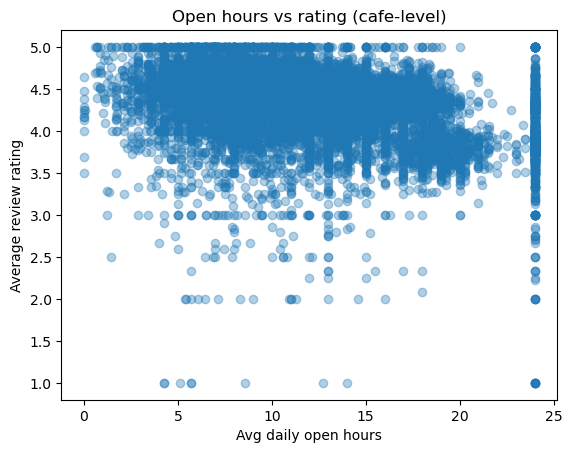

C:\Users\phill\AppData\Local\Temp\ipykernel_24668\1834090317.py:18: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  binned = cafe_avg.groupby(bins)["avg_user_rating"].mean()


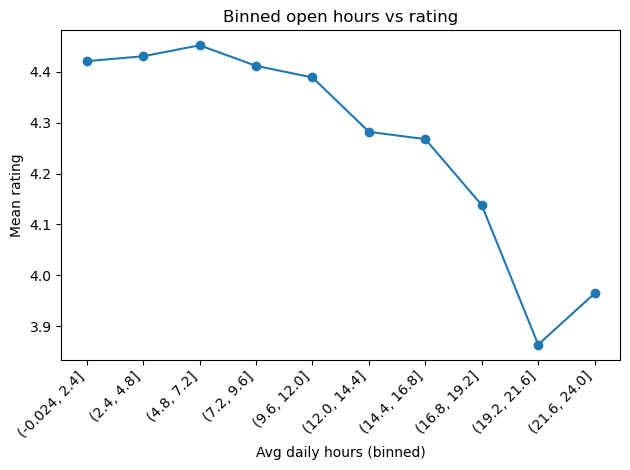

In [5]:
#  VISUALIZING HOURS VS RATING

cafe_avg = df.groupby("gmap_id").agg(
    avg_user_rating=("rating","mean"),
    avg_daily_hours=("avg_daily_hours","first"),
).dropna()

plt.figure()
plt.scatter(cafe_avg["avg_daily_hours"], cafe_avg["avg_user_rating"], alpha=0.35)
plt.xlabel("Avg daily open hours")
plt.ylabel("Average review rating")
plt.title("Open hours vs rating (cafe-level)")
plt.show()

# binned trend
plt.figure()
bins = pd.cut(cafe_avg["avg_daily_hours"], bins=10)
binned = cafe_avg.groupby(bins)["avg_user_rating"].mean()
plt.plot(binned.index.astype(str), binned.values, marker="o")
plt.xticks(rotation=45, ha="right")
plt.xlabel("Avg daily hours (binned)")
plt.ylabel("Mean rating")
plt.title("Binned open hours vs rating")
plt.tight_layout()
plt.show()


C:\Users\phill\AppData\Local\Temp\ipykernel_24668\1534380167.py:17: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  reviews_time["month"] = reviews_time["timestamp"].dt.to_period("M").dt.to_timestamp()


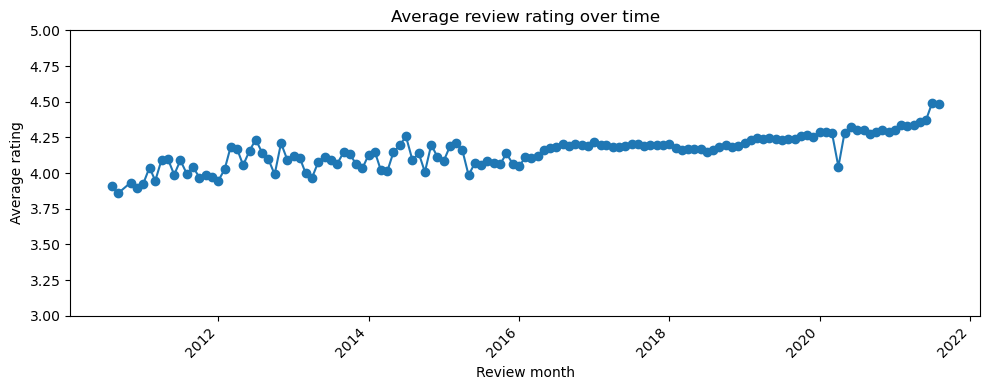

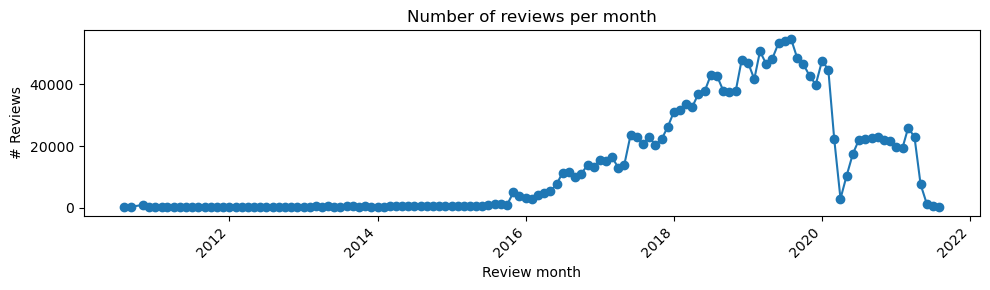

In [16]:
# REVIEW TIME VS AVERAGE RATING

reviews_time = reviews.copy()

# making sure the rating is numeric
reviews_time["rating"] = pd.to_numeric(reviews_time["rating"], errors="coerce")

# convert Unix MS to UTC time
reviews_time["timestamp"] = pd.to_datetime(
    reviews_time["time"],
    unit="ms",
    utc=True
)


reviews_time["date"] = reviews_time["timestamp"].dt.date
reviews_time["month"] = reviews_time["timestamp"].dt.to_period("M").dt.to_timestamp()

# computing average rating per month and number of reviews per month
time_stats = (
    reviews_time
        .dropna(subset=["rating"])
        .groupby("month")
        .agg(
            avg_rating=("rating", "mean"),
            num_reviews=("rating", "count")
        )
        .reset_index()
)

min_reviews = 100  # change to change the number of minimum reviews needed
time_stats = time_stats[time_stats["num_reviews"] >= min_reviews]

time_stats = time_stats[time_stats["month"] >= "2008-01-01"] # change to change time period, set at 2008 and after currently

plt.figure(figsize=(10, 4))
plt.plot(time_stats["month"], time_stats["avg_rating"], marker="o", linestyle="-")
plt.xlabel("Review month")
plt.ylabel("Average rating")
plt.title("Average review rating over time")
plt.xticks(rotation=45, ha="right")
plt.ylim(3.0, 5.0)  # Dictating the rating range to be only 3 - 5 so we can see changes in graph
plt.tight_layout()
plt.show()

# Number of reviews per month graph
plt.figure(figsize=(10, 3))
plt.plot(time_stats["month"], time_stats["num_reviews"], marker="o", linestyle="-")
plt.xlabel("Review month")
plt.ylabel("# Reviews")
plt.title("Number of reviews per month")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


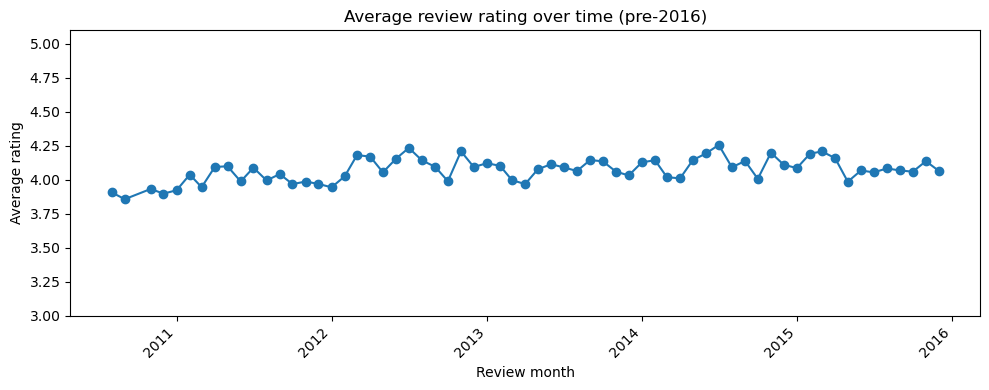

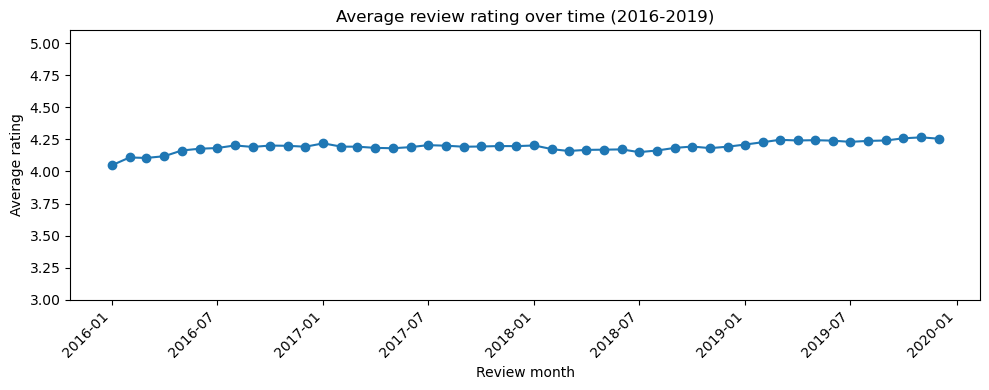

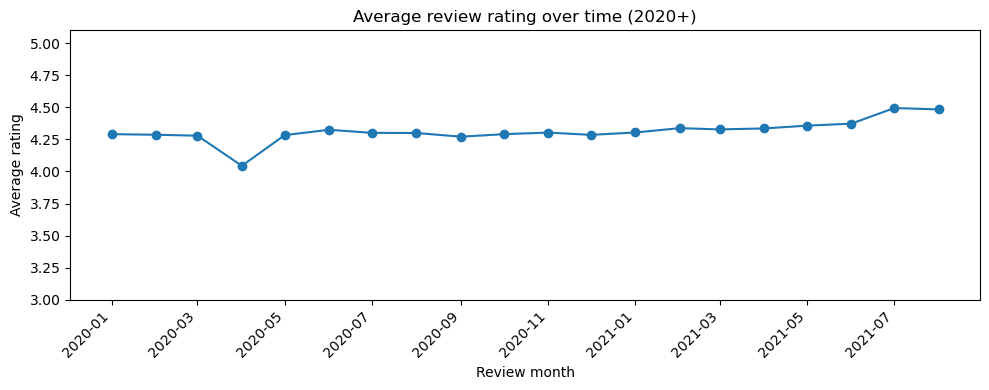

In [24]:
# REVIEW TIME VS AVERAGE RATING (SPLIT INTO 3 TIME PERIODS)

reviews_time = reviews.copy()
reviews_time["rating"] = pd.to_numeric(reviews_time["rating"], errors="coerce")

# converting Unix ms
reviews_time["timestamp"] = pd.to_datetime(
    reviews_time["time"],
    unit="ms"
)

# Bucketing by month
reviews_time["month"] = reviews_time["timestamp"].dt.to_period("M").dt.to_timestamp()

time_stats = (
    reviews_time
        .dropna(subset=["rating"])
        .groupby("month")
        .agg(
            avg_rating=("rating", "mean"),
            num_reviews=("rating", "count")
        )
        .reset_index()
)

# Creating time boundaries // can change if we want
boundary_2016 = pd.Timestamp("2016-01-01")
boundary_2020 = pd.Timestamp("2020-01-01")
# Converting boundaries to Unix ms for the numeric category function
boundary_2016_ms = int(boundary_2016.timestamp() * 1000)
boundary_2020_ms = int(boundary_2020.timestamp() * 1000)

def unix_ms_to_period(unix_ms):
    """
      0 -> before 2016
      1 -> 2016-2019
      2 -> 2020 and later
    """
    if pd.isna(unix_ms):
        return np.nan
    try:
        t = int(unix_ms)
    except (ValueError, TypeError):
        return np.nan

    if t < boundary_2016_ms:
        return 0
    elif t < boundary_2020_ms:
        return 1
    else:
        return 2

reviews["time_period"] = reviews["time"].apply(unix_ms_to_period)

# Label function for plotting
def label_period(ts):
    if ts < boundary_2016:
        return "pre-2016"
    elif ts < boundary_2020:
        return "2016-2019"
    else:
        return "2020+"

time_stats["period"] = time_stats["month"].apply(label_period)

# Minimum # of reviews per month
min_reviews = 100

# Plotting one graph per period
for label in ["pre-2016", "2016-2019", "2020+"]:
    ts = time_stats[time_stats["period"] == label].copy()
    ts = ts[ts["num_reviews"] >= min_reviews]
    if ts.empty:
        continue  # in case the early period has no data

    ts = ts.sort_values("month")

    plt.figure(figsize=(10, 4))
    plt.plot(ts["month"], ts["avg_rating"], marker="o", linestyle="-")
    plt.xlabel("Review month")
    plt.ylabel("Average rating")
    plt.title(f"Average review rating over time ({label})")
    plt.xticks(rotation=45, ha="right")
    plt.ylim(3.0, 5.1)  # focusing on reasonable ratings // can change
    plt.tight_layout()
    plt.show()


C:\Users\phill\AppData\Local\Temp\ipykernel_24668\598947094.py:11: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


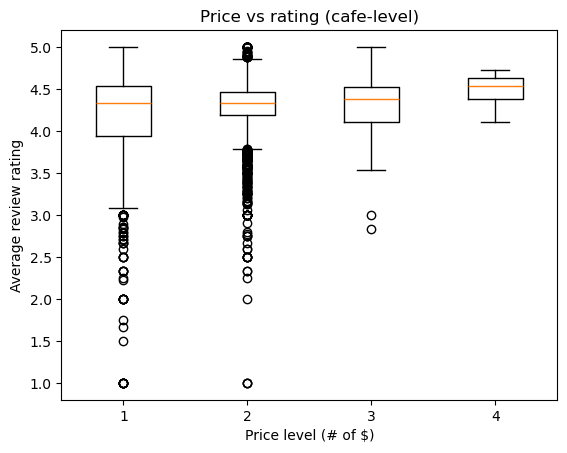

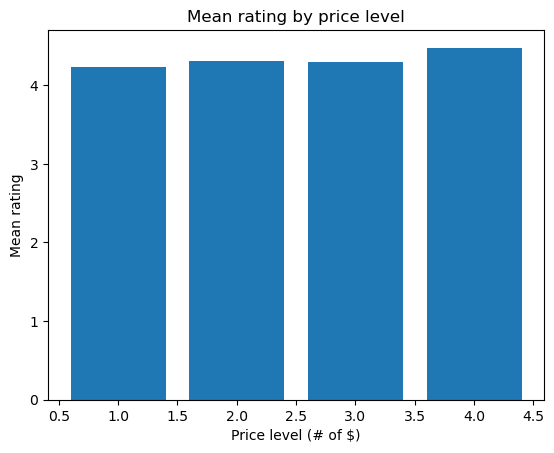

In [6]:
# VISUALIZING PRICE VS RATING

cafe_avg_price = df.groupby("gmap_id").agg(
    avg_user_rating=("rating","mean"),
    price_num=("price_num","first")
).dropna()

levels = sorted(cafe_avg_price["price_num"].unique())

plt.figure()
plt.boxplot(
    [cafe_avg_price[cafe_avg_price["price_num"]==k]["avg_user_rating"] for k in levels],
    labels=[int(k) for k in levels]
)
plt.xlabel("Price level (# of $)")
plt.ylabel("Average review rating")
plt.title("Price vs rating (cafe-level)")
plt.show()

plt.figure()
means = cafe_avg_price.groupby("price_num")["avg_user_rating"].mean()
plt.bar(means.index.astype(int), means.values)
plt.xlabel("Price level (# of $)")
plt.ylabel("Mean rating")
plt.title("Mean rating by price level")
plt.show()


In [7]:
# VISUALIZING GEOGRAPHIC MAP OF CAFES + COUNTY AVG RATING CHOROPLETH

cafes_map = cafes.dropna(subset=["latitude","longitude"]).copy()
cafes_map["avg_rating"] = pd.to_numeric(cafes_map["avg_rating"], errors="coerce")

# base map
map = folium.Map(
    location=[36.5, -119.5],
    zoom_start=6
)

# california outline from github
ca_geojson_url = "https://raw.githubusercontent.com/glynnbird/usstatesgeojson/master/california.geojson"

folium.GeoJson(
    ca_geojson_url,
    name="California outline",
    style_function=lambda feature: {
        "fillColor": "#ffffff",
        "color": "black",
        "weight": 3,
        "fillOpacity": 0.05
    }
).add_to(map)

# california counties from github
counties_url = "https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/california-counties.geojson"
counties_geo = requests.get(counties_url).json()

# converting counties to polygons for averages
county_polys = []
for feat in counties_geo["features"]:
    county_name = feat["properties"]["name"]
    poly = prep(shape(feat["geometry"]))
    county_polys.append((county_name, poly))

# assigning county to each cafe based on lat/long
def find_county(lat, long):
    pt = Point(long, lat)
    for cname, poly in county_polys:
        if poly.contains(pt):
            return cname
    return np.nan

cafes_map["county"] = cafes_map.apply(
    lambda r: find_county(r["latitude"], r["longitude"]),
    axis=1
)

# getting average rating per county
county_stats = (
    cafes_map.dropna(subset=["county"]) # removes cafes without county label so they aren't computed in average
             .groupby("county")
             .agg(avg_rating=("avg_rating", "mean"))
             .reset_index()
)

# choropleth coloring counties by average rating
folium.Choropleth(
    geo_data=counties_geo,
    name="Average rating per county",
    data=county_stats,
    columns=["county", "avg_rating"],
    key_on="feature.properties.name",
    fill_color="YlGnBu",
    fill_opacity=0.7,
    line_opacity=0.3,
    nan_fill_color="white",
    legend_name="Average cafe rating"
).add_to(map)

# cafe markers
cluster = MarkerCluster(name="Cafe markers").add_to(map)

for _, r in cafes_map.iterrows():
    popup = (
        f"{r.get('name','')}"
        f"<br>Rating: {r.get('avg_rating',np.nan)}"
        f"<br>Price: {r.get('price','')}"
        f"<br>County: {r.get('county','')}"
    )
    folium.CircleMarker(
        location=[r["latitude"], r["longitude"]],
        radius=2.5,
        color="black",
        weight=0.5,
        fill=True,
        fill_opacity=0.7,
        popup=popup
    ).add_to(cluster)

# Toggle panel so we can show/hide features
folium.LayerControl(collapsed=False).add_to(map)
map
